## Work in progress

In [1]:
# Import necessary modules 
from earthscopestraintools.mseed_tools import ts_from_mseed
from earthscopestraintools.gtsm_metadata import GtsmMetadata
from earthscopestraintools.timeseries import plot_timeseries_comparison

# Establish logging session
import logging
logger = logging.getLogger()
logging.basicConfig(
        format="%(message)s", level=logging.INFO
    )


## Aquire data and metadata

**Exercise:** Gather metadata and data from B073 for the month of May 2012 by filling in the blanks. 

**Goal:** Understand the metadata and data structure.

In [2]:
# Get metadata and data

# First, set parameters for the seed code
network = 'PB' 
station = 'B073'
location = 'T0' # The location code for strain is T0
sample_rate = 'LS*' # LS = 1 Hz, * denotes data from all 4 gauges should be acquired

start = '2012-05-05T00:00:00.00'
end = '2012-05-10T00:00:00.00'

# Get the metadata
meta = GtsmMetadata(network=network,station=station)

# Get the data from the IRIS DMC 
strain_raw = ts_from_mseed(network=network,station=station,location=location,channel=sample_rate,start=start,end=end)


PB B073 Loading T0 LS* from 2012-05-05T00:00:00.00 to 2012-05-10T00:00:00.00 from Earthscope DMC miniseed
    Trace 1. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping LS1 to CH0
    Trace 2. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping LS2 to CH1
    Trace 3. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping LS3 to CH2
    Trace 4. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping LS4 to CH3
    Found 0 epochs with nans, 123.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%
  Converting 999999 gap fill values to nan
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


In [3]:
# Examine the metadata contents through the .show() call 
meta.show()

network: PB
station: B073
latitude: 35.9467
longitude: -120.4717
gap: 0.0001
orientation (CH0EofN): 270.1
reference_strains:
 {'linear_date': '2006:305', 'CH0': 48574128, 'CH1': 53068331, 'CH2': 47998858, 'CH3': 48278313}
strain_matrices:
lab:
 [[ 0.29629699  0.5185182   0.29629592  0.22222222]
 [ 0.37081499 -0.18406666 -0.29718805  0.11043972]
 [ 0.12700876  0.32139321 -0.25556544 -0.19283653]]
ER2010:
 [[-0.88182914 -0.81225113 -0.57421371 -0.60171802]
 [ 0.47546729 -0.31102462 -0.63122543 -0.04953135]
 [ 0.16962093  0.42674938 -0.62218982 -0.47306098]]
CH_prelim:
 None
atmp_response:
 {'CH0': -0.012, 'CH1': -0.01, 'CH2': -0.0079, 'CH3': -0.0076}
tidal_params:
 {('CH0', 'M2', 'phz'): '-172.163', ('CH0', 'M2', 'amp'): '10.679', ('CH0', 'M2', 'doodson'): '2 0 0 0 0 0', ('CH0', 'O1', 'phz'): '-167.318', ('CH0', 'O1', 'amp'): '2.925', ('CH0', 'O1', 'doodson'): '1-1 0 0 0 0', ('CH0', 'P1', 'phz'): '-175.695', ('CH0', 'P1', 'amp'): '1.056', ('CH0', 'P1', 'doodson'): '1 1-2 0 0 0', ('CH0', 

In [4]:
# Run this code cellto look at available attributes and functions of strain_raw
print('Attributes:')
funcs = []
print(list(vars(strain_raw).keys()))
for s in dir(strain_raw): 
    if s.startswith('_') != True and s not in vars(strain_raw).keys(): funcs.append(s)
print('Functions')
print(funcs)


Attributes:
['data', 'columns', 'quality_df', 'period', 'series', 'units', 'level', 'network', 'station', 'name', 'nans', 'nines', 'epochs', 'gap_percentage']
Functions
['apply_calibration_matrix', 'apply_corrections', 'baytap_analysis', 'butterworth_filter', 'calculate_magnitude', 'calculate_offsets', 'calculate_pressure_correction', 'calculate_tide_correction', 'check_for_gaps', 'decimate_1s_to_300s', 'decimate_to_hourly', 'dynamic_strain', 'infer_period', 'interpolate', 'linear_trend_correction', 'linearize', 'plot', 'remove_fill_values', 'save_csv', 'set_data', 'set_initial_level_flags', 'set_initial_quality_flags', 'set_initial_version', 'set_local_tdb_uri', 'set_s3_tdb_uri', 'set_units', 'show_flagged_data', 'show_flags', 'stats', 'strain_video']


In [5]:
# Preview the data with the attribute
strain_raw.data

,CH0,CH1,CH2,CH3
time,,,,
2012-05-05 00:00:00,47722837.0,56816405.0,40145631.0,41810278.0
2012-05-05 00:00:01,47722833.0,56816404.0,40145635.0,41810277.0
2012-05-05 00:00:02,47722848.0,56816403.0,40145626.0,41810281.0
2012-05-05 00:00:03,47722845.0,56816403.0,40145628.0,41810279.0
2012-05-05 00:00:04,47722836.0,56816402.0,40145636.0,41810278.0
...,...,...,...,...
2012-05-09 23:59:55,47721669.0,56820317.0,40139114.0,41804033.0
2012-05-09 23:59:56,47721667.0,56820317.0,40139116.0,41804030.0
2012-05-09 23:59:57,47721667.0,56820320.0,40139113.0,41804027.0


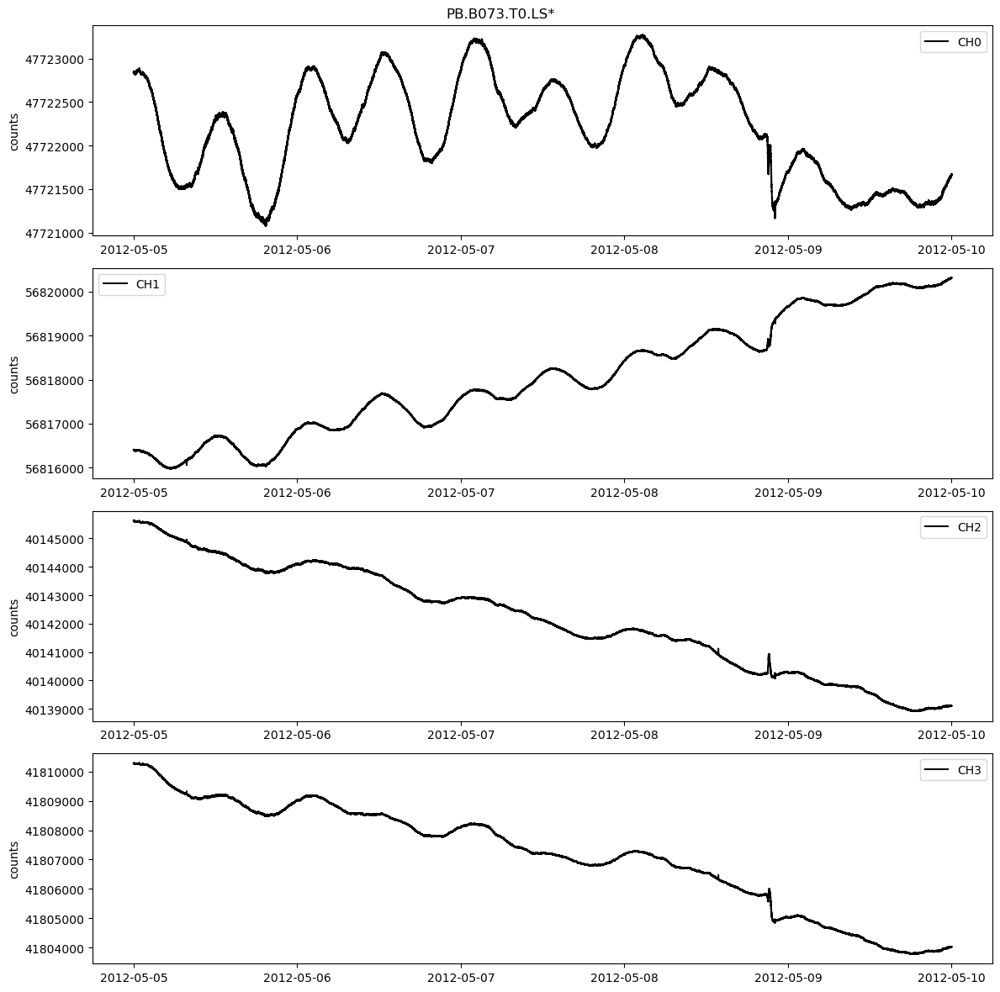

In [6]:
# Use one of the functions to plot the data
strain_raw.plot()

## Linearization

**Exercise:** Convert the raw data in counts to microstrain through linearization. 

**Goal:** Learn how to use the linearization function. 

In [7]:
# Linearize
gauge_microstrain = strain_raw.linearize(reference_strains=meta.reference_strains,gap=meta.gap)
# Preview the data
gauge_microstrain.data

Converting raw counts to microstrain
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


,CH0,CH1,CH2,CH3
time,,,,
2012-05-05 00:00:00,-36.396960,212.571047,-290.014799,-247.021153
2012-05-05 00:00:01,-36.397128,212.570985,-290.014671,-247.021187
2012-05-05 00:00:02,-36.396498,212.570923,-290.014960,-247.021051
2012-05-05 00:00:03,-36.396624,212.570923,-290.014896,-247.021119
2012-05-05 00:00:04,-36.397002,212.570862,-290.014639,-247.021153
...,...,...,...,...
2012-05-09 23:59:55,-36.446084,212.812193,-290.223868,-247.233123
2012-05-09 23:59:56,-36.446168,212.812193,-290.223804,-247.233225
2012-05-09 23:59:57,-36.446168,212.812378,-290.223900,-247.233326


## Calculate regional strains

**Exercise:** Examine and apply the available calibration matrices.

**Goal:** Learn how to produce regional strains (areal, differential, and shear). 

In [8]:
# Which strain matrices are available in the metadata?
meta.strain_matrices

{'lab': array([[ 0.29629699,  0.5185182 ,  0.29629592,  0.22222222],
        [ 0.37081499, -0.18406666, -0.29718805,  0.11043972],
        [ 0.12700876,  0.32139321, -0.25556544, -0.19283653]]),
 'ER2010': array([[-0.88182914, -0.81225113, -0.57421371, -0.60171802],
        [ 0.47546729, -0.31102462, -0.63122543, -0.04953135],
        [ 0.16962093,  0.42674938, -0.62218982, -0.47306098]]),
 'CH_prelim': None}

In [9]:
# Apply both strain matrices to the gauge microstrain
lab_strain = gauge_microstrain.apply_calibration_matrix(meta.strain_matrices['lab'])
tide_strain = gauge_microstrain.apply_calibration_matrix(meta.strain_matrices['ER2010'])

Applying None matrix: [[ 0.29629699  0.5185182   0.29629592  0.22222222]
 [ 0.37081499 -0.18406666 -0.29718805  0.11043972]
 [ 0.12700876  0.32139321 -0.25556544 -0.19283653]]
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%
Applying None matrix: [[-0.88182914 -0.81225113 -0.57421371 -0.60171802]
 [ 0.47546729 -0.31102462 -0.63122543 -0.04953135]
 [ 0.16962093  0.42674938 -0.62218982 -0.47306098]]
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


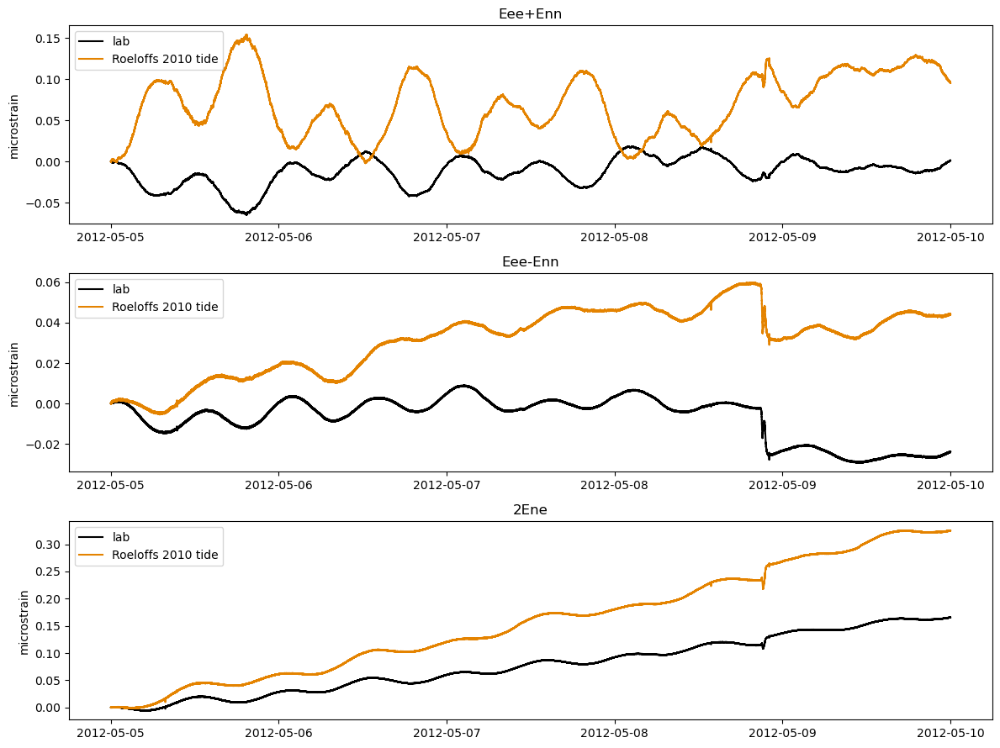

In [10]:
# Use a tool to plot a comparison of the matrices
plot_timeseries_comparison([lab_strain,tide_strain],names=['lab','Roeloffs 2010 tide'],zero=True)

## Signal correction

**Exercise:** Correct the strain timeseries for barometric pressure, tides, trend and optionally offsets. 

**Goal:** Understand the available corrections and how to correct the time series. 


### Barometric Pressure Correction

Seed codes for applying the pressure correction are listed on this [page](https://earthscopestraintools.readthedocs.io/en/latest/pages/DataAvailability.html).

In [11]:
# First, get the atmospheric pressure data
atmp = ts_from_mseed(network=network,station=station,location='TS',channel='RDO',
                     period=60*30,scale_factor=0.001,start=start,end=end) # scale factor

PB B073 Loading TS RDO from 2012-05-05T00:00:00.00 to 2012-05-10T00:00:00.00 from Earthscope DMC miniseed
    Trace 1. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping RDO to atmp
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%
  Converting 999999 gap fill values to nan
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


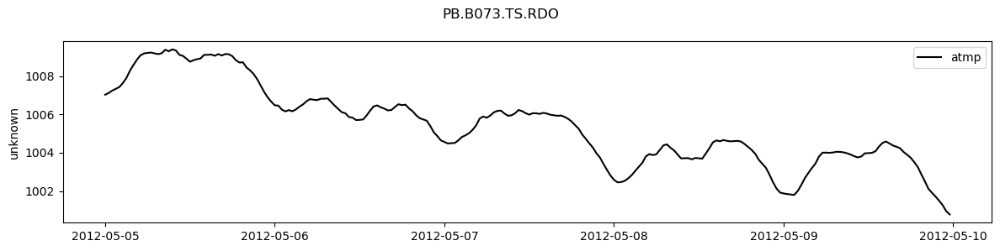

In [12]:
# Plot the correction
atmp.plot()

In [13]:
# Examine the pressure response coefficients per gauge
# in microstrain/hPa
meta.atmp_response

{'CH0': -0.012, 'CH1': -0.01, 'CH2': -0.0079, 'CH3': -0.0076}

In [14]:
# Interpolate the pressure data to the timeseries
atmp_interp = atmp.interpolate(new_index=gauge_microstrain.data.index, series='hpa')

Interpolating data using method=linear and limit=3600
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


In [15]:
# Calculate the pressure correction
atmp_c = atmp_interp.calculate_pressure_correction(response_coefficients=meta.atmp_response)

Calculating pressure correction
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


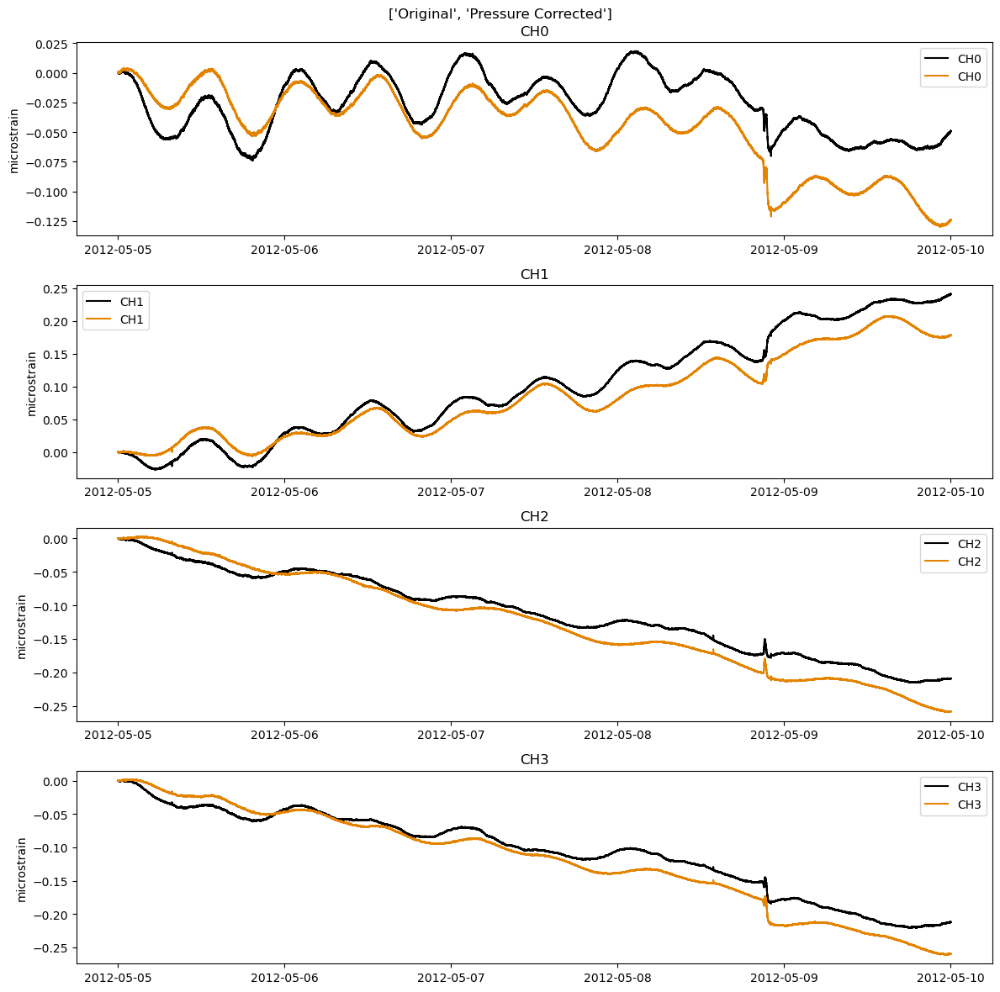

In [16]:
# Plot the applied corrections
# The .apply_corrections() function is useful for this purpose
plot_timeseries_comparison([gauge_microstrain,gauge_microstrain.apply_corrections([atmp_c])],
                           ['Original','Pressure Corrected'],zero=True)

### Tide Correction


In [17]:
# Take a look at the metadata for the tides
meta.tidal_params

{('CH0', 'M2', 'phz'): '-172.163',
 ('CH0', 'M2', 'amp'): '10.679',
 ('CH0', 'M2', 'doodson'): '2 0 0 0 0 0',
 ('CH0', 'O1', 'phz'): '-167.318',
 ('CH0', 'O1', 'amp'): '2.925',
 ('CH0', 'O1', 'doodson'): '1-1 0 0 0 0',
 ('CH0', 'P1', 'phz'): '-175.695',
 ('CH0', 'P1', 'amp'): '1.056',
 ('CH0', 'P1', 'doodson'): '1 1-2 0 0 0',
 ('CH0', 'K1', 'phz'): '-160.382',
 ('CH0', 'K1', 'amp'): '2.704',
 ('CH0', 'K1', 'doodson'): '1 1 0 0 0 0',
 ('CH0', 'N2', 'phz'): '179.368',
 ('CH0', 'N2', 'amp'): '1.958',
 ('CH0', 'N2', 'doodson'): '2-1 0 1 0 0',
 ('CH0', 'S2', 'phz'): '-175.747',
 ('CH0', 'S2', 'amp'): '6.275',
 ('CH0', 'S2', 'doodson'): '2 2-2 0 0 0',
 ('CH1', 'M2', 'phz'): '-148.679',
 ('CH1', 'M2', 'amp'): '7.809',
 ('CH1', 'M2', 'doodson'): '2 0 0 0 0 0',
 ('CH1', 'O1', 'phz'): '143.932',
 ('CH1', 'O1', 'amp'): '4.237',
 ('CH1', 'O1', 'doodson'): '1-1 0 0 0 0',
 ('CH1', 'P1', 'phz'): '139.121',
 ('CH1', 'P1', 'amp'): '1.976',
 ('CH1', 'P1', 'doodson'): '1 1-2 0 0 0',
 ('CH1', 'K1', 'phz')

In [18]:
# Calculate tidal corrections for each gauge
tide_c = gauge_microstrain.calculate_tide_correction(tidal_parameters=meta.tidal_params,
                                                     longitude=meta.longitude)

Calculating tide correction
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


### Trend Correction

**Go to [the API documentation in readthedocs](https://earthscopestraintools.readthedocs.io/en/latest/api/earthscopestraintools.processing.html#earthscopestraintools.processing.calculate_linear_trend_correction) and examine the options for computing the linear trend**

In [19]:
# Calculate the trend correction for each gauge
# Sometimes correcting for pressure first is the best bet
# because the pressure can have its own trend
trend_c = gauge_microstrain.apply_corrections([atmp_c]).linear_trend_correction(method='linear')


Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%
Calculating linear trend correction
    Trend Start: 2012-05-05 00:00:00
    Trend End: 2012-05-09 23:59:59
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%
Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%
Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


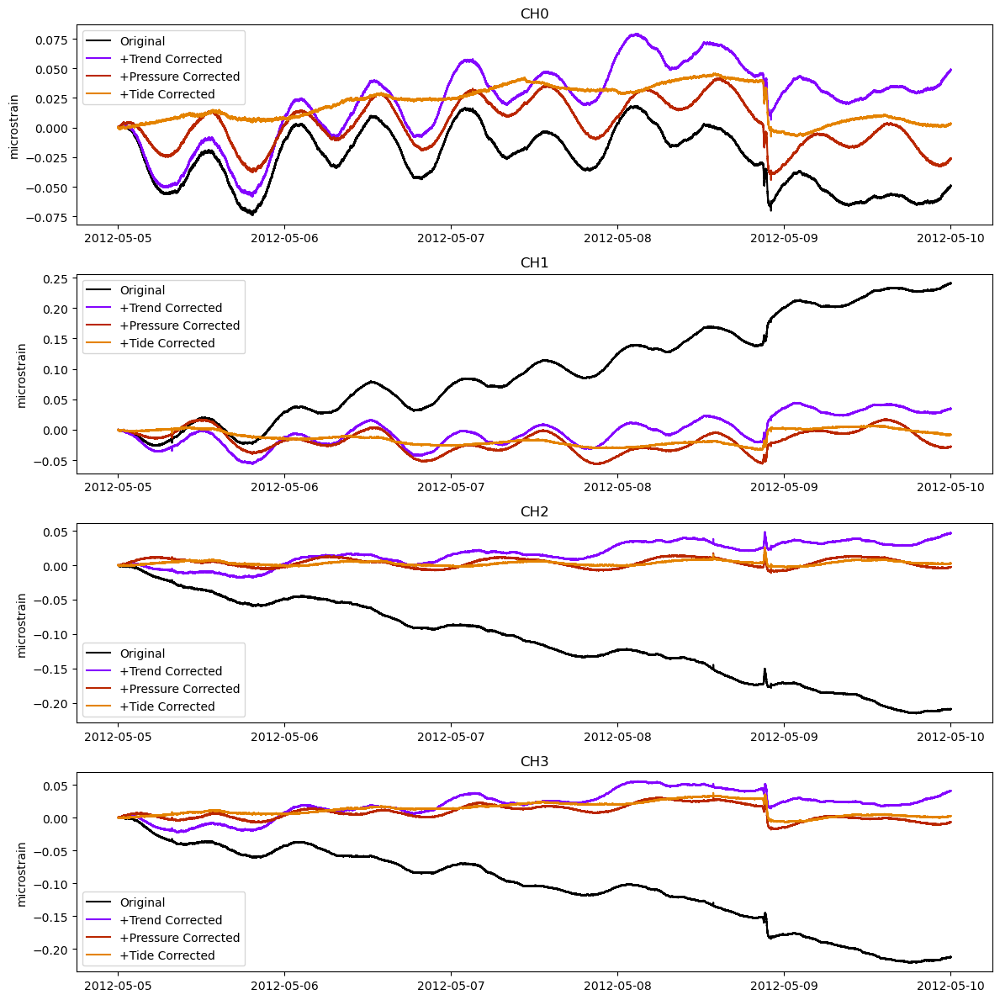

In [20]:
# Plot various applied corrections
p1 = gauge_microstrain.apply_corrections([trend_c])
p2 = gauge_microstrain.apply_corrections([trend_c,atmp_c])
gauge_strain_corr = gauge_microstrain.apply_corrections([trend_c,atmp_c,tide_c])

plot_timeseries_comparison([gauge_microstrain,p1,p2,gauge_strain_corr],zero=True,
                           names=['Original','+Trend Corrected','+Pressure Corrected','+Tide Corrected'])

### Offset correction

See how the simle offset correction calculation is implemented in the [docs](https://earthscopestraintools.readthedocs.io/en/latest/api/earthscopestraintools.processing.html#earthscopestraintools.processing.calculate_offsets).

In [21]:
# Calculate offsets via first differencing above a cutoff limit 
# adjusted to the noise of the data

offset_c = gauge_strain_corr.calculate_offsets(limit_multiplier=25,cutoff_percentile=0.75)


Calculating offsets using cutoff percentile of 0.75 and limit multiplier of 25.
Using offset limits of [0.002346, 0.002162, 0.001911, 0.001829]
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


Applying corrections
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


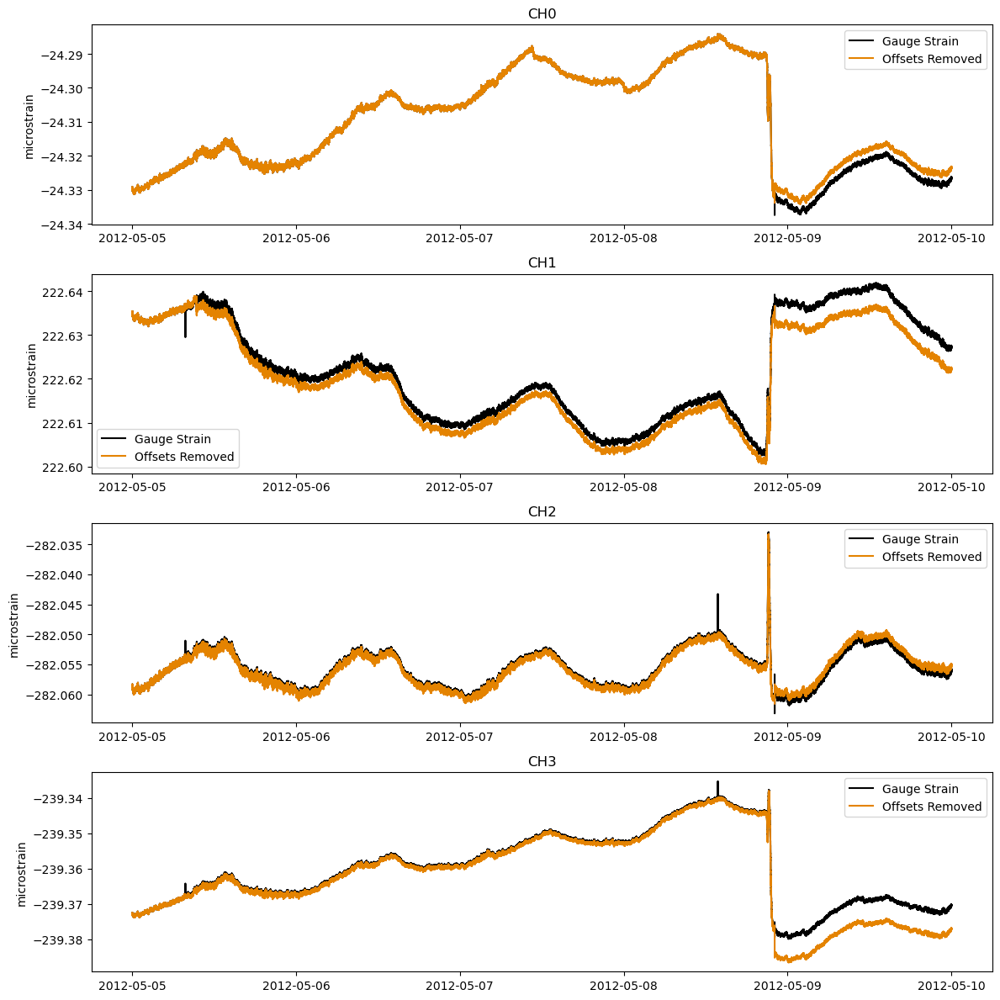

In [22]:
# Plot the offset corrections
# try adjusting the offset calculation parameters in the previous cell to see their effect

plot_timeseries_comparison([gauge_strain_corr,gauge_strain_corr.apply_corrections([offset_c])],
                           names=['Gauge Strain','Offsets Removed'])

**Whether you choose to apply these offsets is up to you, depending on your purpose forusing the data.**

## Tectonic or Nontectonic?

This can be hard to say at times, but one common environmental factor that can cause seemingly anomolous strains is rainfall. Let's get the data and examine the timing or rainfall relative to the jump in the time series above. 


In [23]:
# First, let's transform the corrected gauge strain to regional strain
reg_strain_corr = gauge_strain_corr.apply_calibration_matrix(meta.strain_matrices['ER2010'])

Applying None matrix: [[-0.88182914 -0.81225113 -0.57421371 -0.60171802]
 [ 0.47546729 -0.31102462 -0.63122543 -0.04953135]
 [ 0.16962093  0.42674938 -0.62218982 -0.47306098]]
    Found 123 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.03%


In [24]:
# Get the rainfall data
rain = ts_from_mseed(network=network,station=station,location='TS',channel='RRO',start=start,end=end,scale_factor=0.0001,period=60*30)

PB B073 Loading TS RRO from 2012-05-05T00:00:00.00 to 2012-05-10T00:00:00.00 from Earthscope DMC miniseed
    Trace 1. 2012-05-05T00:00:00.000000Z:2012-05-10T00:00:00.000000Z mapping RRO to rain
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%
  Converting 999999 gap fill values to nan
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%


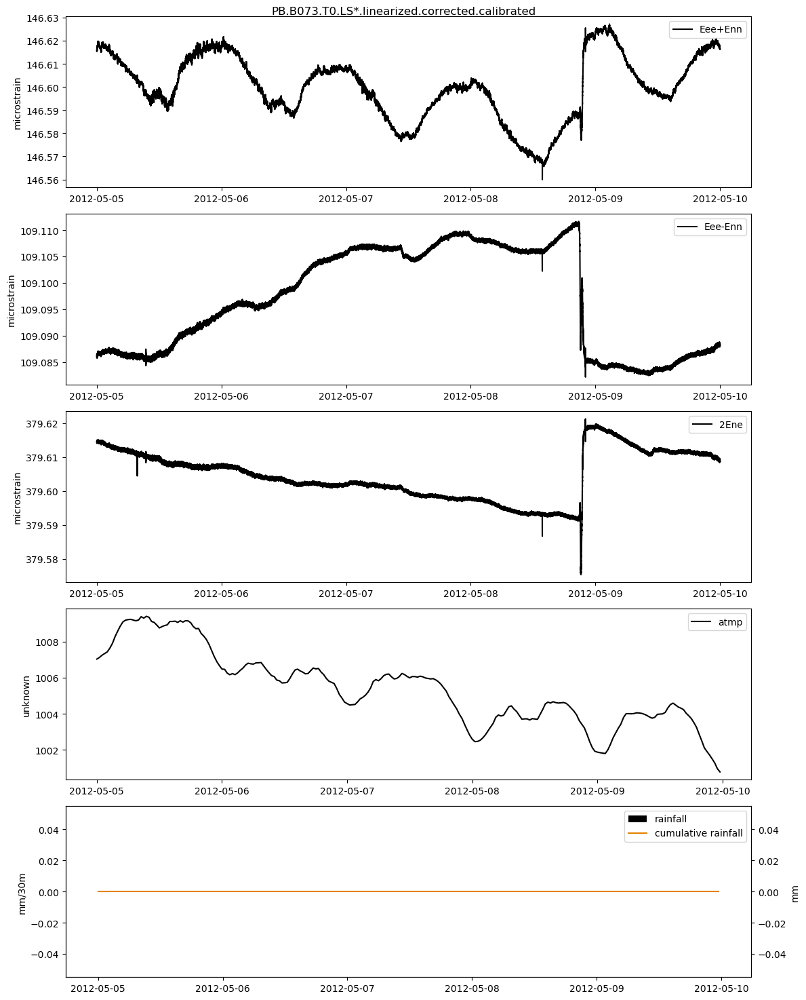

In [25]:
# Plot the rainfall with the corrected regional strains
# Look for residual pressure as well
reg_strain_corr.plot(rainfall=rain,atmp=atmp)

## Strain axes

Let's look at the strain axes alignment in a gif animation. Take a look at the code implementation [here](https://earthscopestraintools.readthedocs.io/en/latest/api/earthscopestraintools.timeseries.html#earthscopestraintools.timeseries.Timeseries.strain_video).

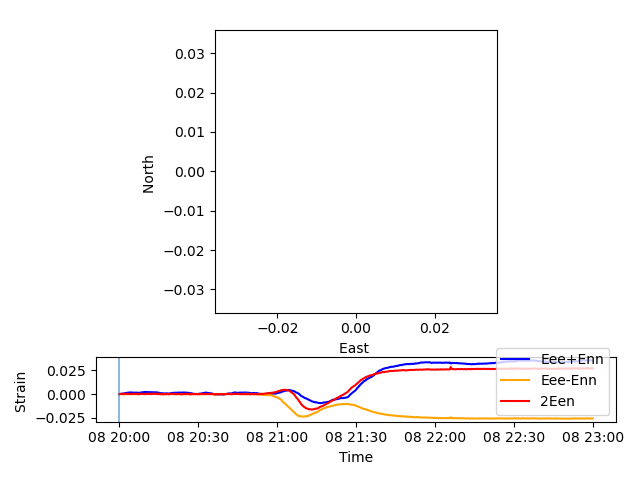

Animation.save using <class 'matplotlib.animation.HTMLWriter'>
Animation size has reached 21010041 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [28]:
# Strain gif
%matplotlib widget
reg_strain_corr.strain_video(start='2012-05-08T20:00:00',end='2012-05-08T23:00:00',
                             skip=20,interval=0.1)

PB B004 Loading T0 RS* from 2019-07-01 to 2019-07-07 from Earthscope DMC miniseed
    Trace 1. 2019-07-01T00:00:00.000000Z:2019-07-07T00:00:00.000000Z mapping RS1 to CH0
    Trace 2. 2019-07-01T00:00:00.000000Z:2019-07-07T00:00:00.000000Z mapping RS2 to CH1
    Trace 3. 2019-07-01T00:00:00.000000Z:2019-07-07T00:00:00.000000Z mapping RS3 to CH2
    Trace 4. 2019-07-01T00:00:00.000000Z:2019-07-07T00:00:00.000000Z mapping RS4 to CH3
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%
  Converting 999999 gap fill values to nan
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%
Converting raw counts to microstrain
    Found 0 epochs with nans, 0.0 epochs with 999999s, and 0 missing epochs.
    Total missing data is 0.0%
Applying None matrix: [[ 1.65662916  2.37718929  2.36230912  0.39952254]
 [-0.04469343  0.51274012  0.50047667 -0.09672701]
 [ 0.39438025  1.05488877  1.64758286 

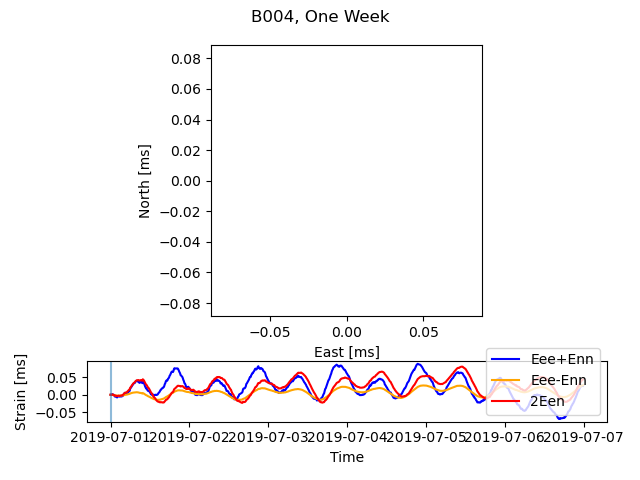

In [27]:
# Import relevant modules from the earscopestraintools package
from earthscopestraintools.mseed_tools import ts_from_mseed
from earthscopestraintools.gtsm_metadata import GtsmMetadata
# Metadata
network = 'PB'
station = 'B004'
meta = GtsmMetadata(network,station)
# Provide the start and end times
start = '2019-07-01'
end = '2019-07-07'

# load data
%matplotlib widget
strain_raw = ts_from_mseed(network=network, station=station, location='T0', channel='RS*', start=start, end=end)
strain_linearized = strain_raw.linearize(reference_strains=meta.reference_strains,gap=meta.gap)
strain_reg = strain_linearized.apply_calibration_matrix(calibration_matrix=meta.strain_matrices['ER2010'])
# make video, save .gif
anim = strain_reg.strain_video(interval=1, title=f'{station}, One Week',units='ms')#,savegif=f'{station}.{start}.{end}.gif')

## Exercise: Nontectonic signals and corrections
- Linear trend removal (median and regular least squares)
- Rainfall exercise: potential date range and station TSM1 Nov 20-25 2023
 ts_from_mseed()

## Exercise: Find the best fault geometry to fit the data

(Ask Eric Lindsey for permission to use his format of the python Okada Code)